In [55]:
import os
os.environ["ONNXRUNTIME_EXECUTION_PROVIDERS"] = "[CUDAExecutionProvider]"

from inference import get_model

ROBOFLOW_API_KEY = 'tCy476DHnSoq6mwGtVpp'
PLAYER_DETECTION_MODEL_ID = 'football-players-detection-3zvbc/2'
PLAYER_DETECTION_MODEL = get_model(PLAYER_DETECTION_MODEL_ID, ROBOFLOW_API_KEY)

In [56]:
SOURCE_VIDEO_PATH = "../data/videos/new-5s.mp4"

import supervision as sv
from tqdm import tqdm

BALL_ID = 0
PLAYER_ID = 1

label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#FF8C00', '#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000')
)

ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#FF8C00', '#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=25,
    height=21,
    outline_thickness=1
)

In [57]:
frames = []

for frame_index, frame in enumerate(sv.get_video_frames_generator(SOURCE_VIDEO_PATH)):
    if frame_index % 5 == 0:  # Save only every 5th frame
        frames.append(frame)

print(f"Total frames collected: {len(frames)}")

Total frames collected: 31


Frame 0


Processing...:   0%|          | 0/31 [00:00<?, ?it/s]

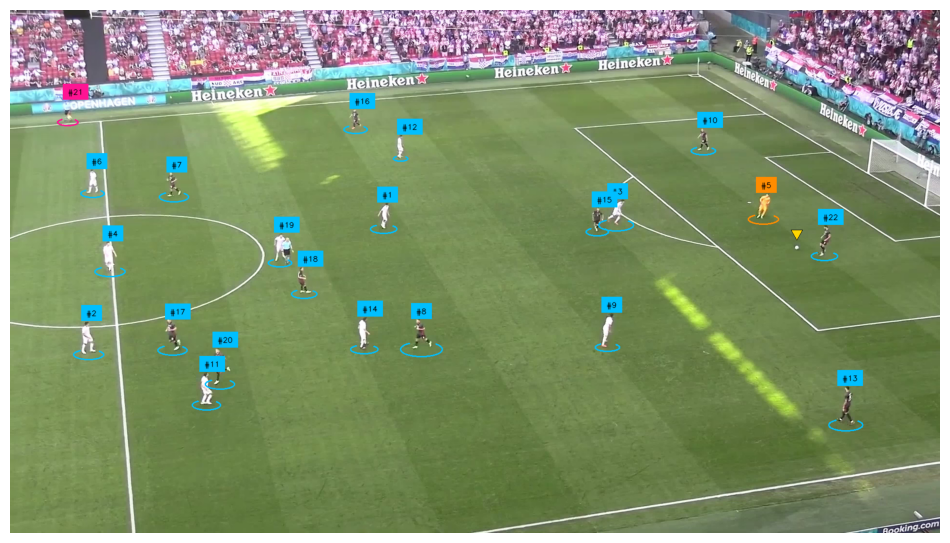

Frame 1


Processing...:   3%|▎         | 1/31 [00:03<01:41,  3.39s/it]

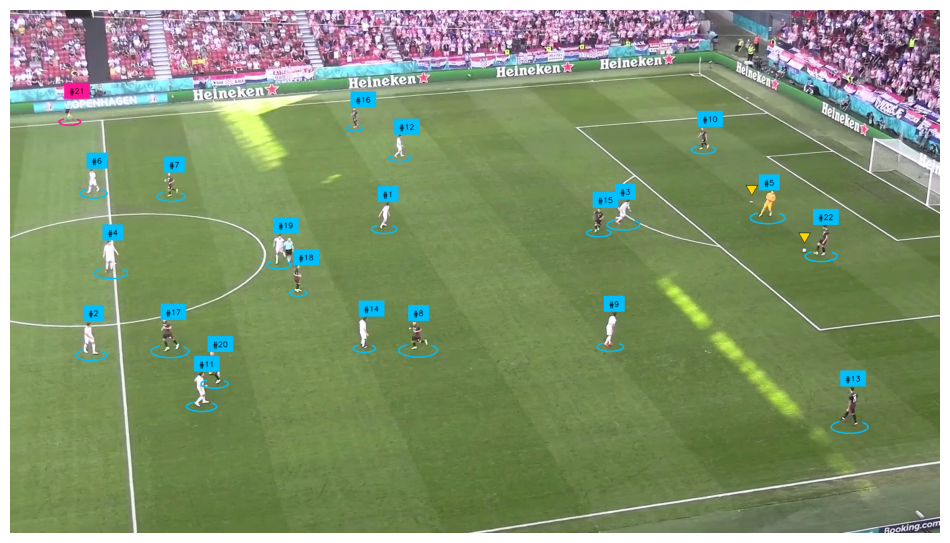

Frame 2


Processing...:   6%|▋         | 2/31 [00:05<01:17,  2.68s/it]

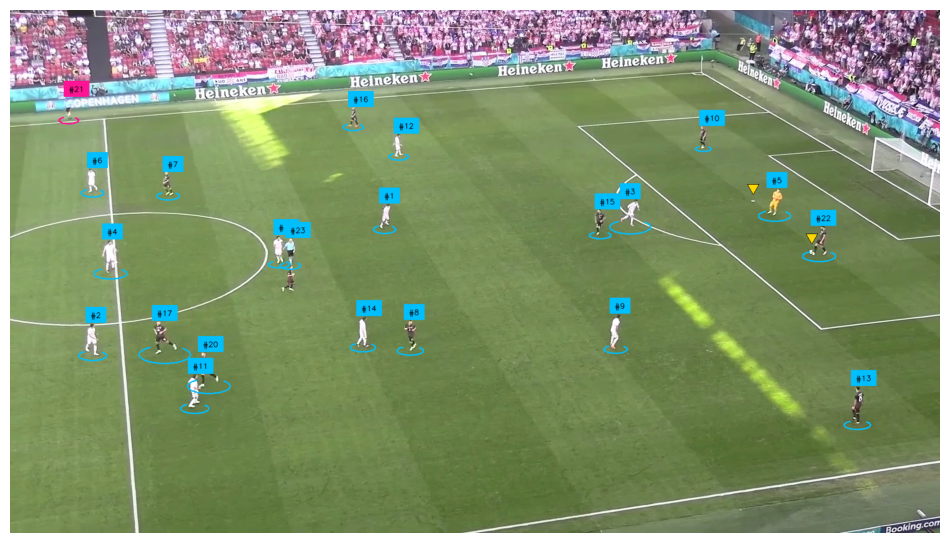

Frame 3


Processing...:  10%|▉         | 3/31 [00:07<01:05,  2.34s/it]

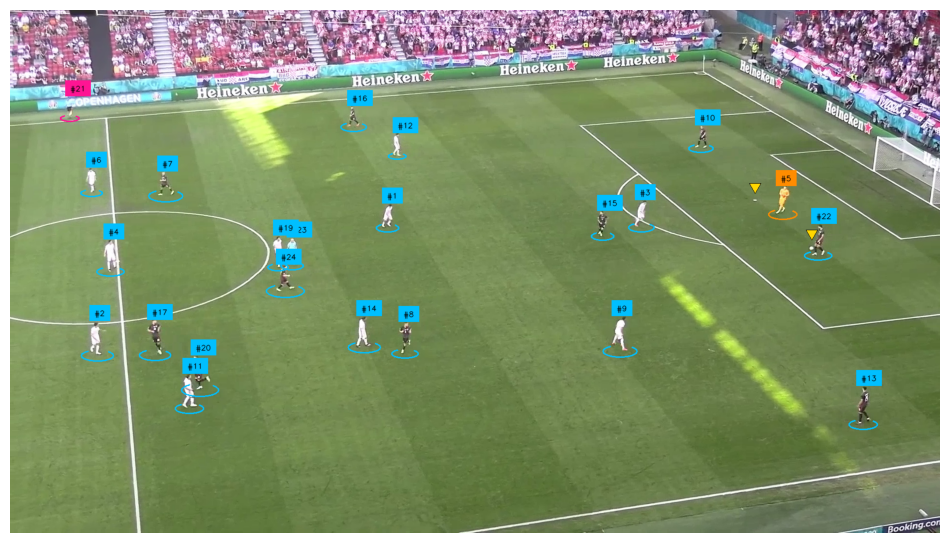

Frame 4


Processing...:  13%|█▎        | 4/31 [00:09<00:57,  2.13s/it]

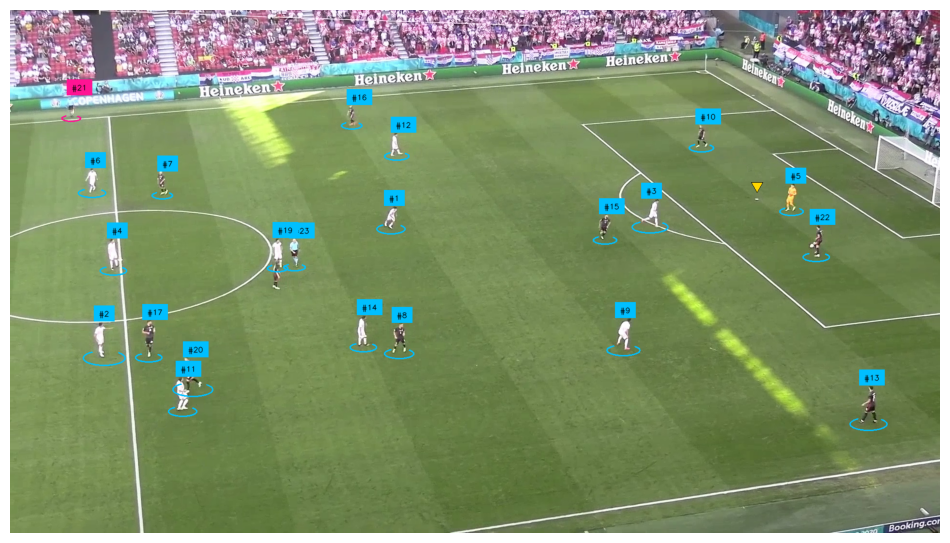

Frame 5


Processing...:  16%|█▌        | 5/31 [00:11<00:54,  2.10s/it]

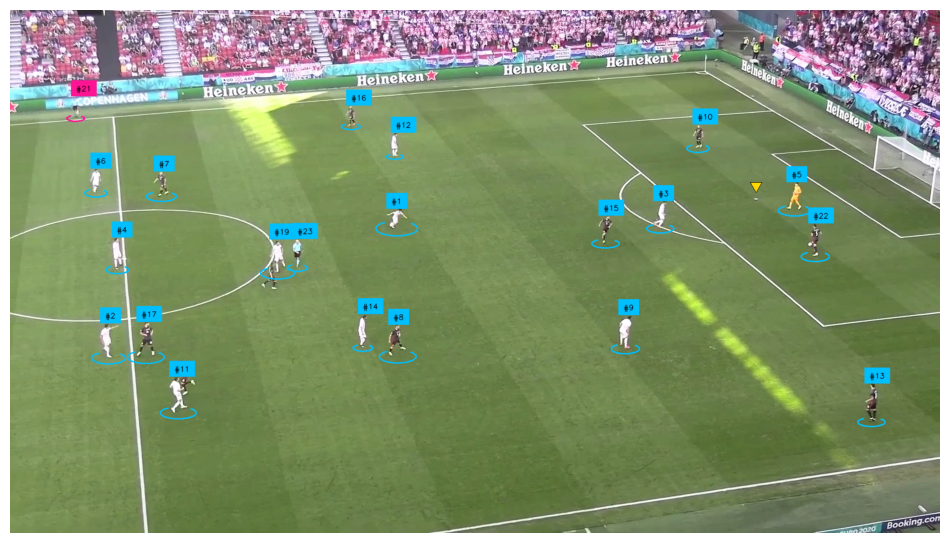

Frame 6


Processing...:  19%|█▉        | 6/31 [00:13<00:52,  2.11s/it]

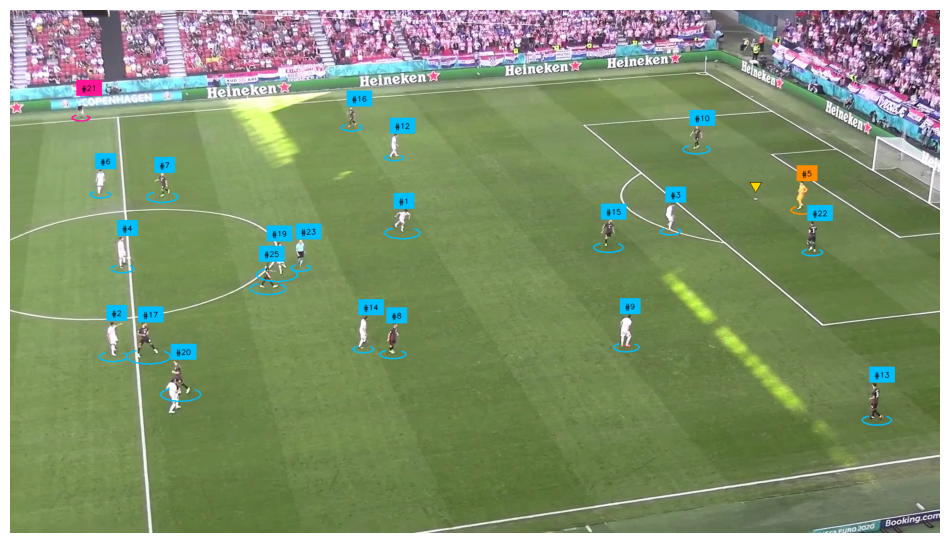

Frame 7


Processing...:  23%|██▎       | 7/31 [00:15<00:49,  2.05s/it]

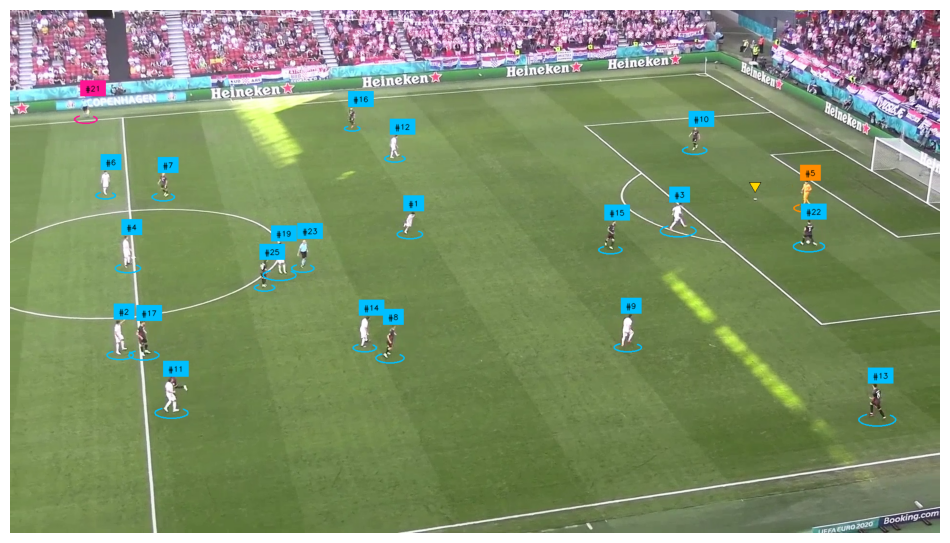

Frame 8


Processing...:  26%|██▌       | 8/31 [00:17<00:45,  1.99s/it]

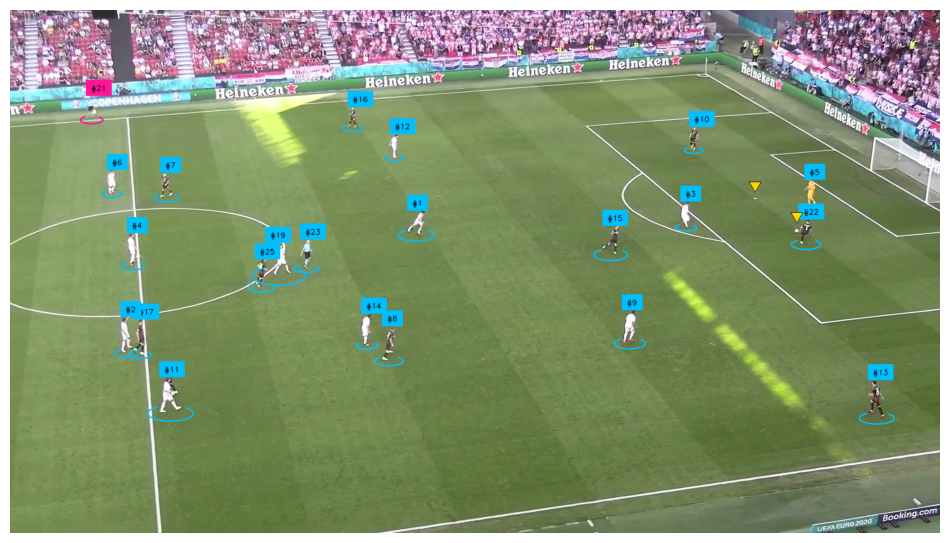

Frame 9


Processing...:  29%|██▉       | 9/31 [00:19<00:42,  1.95s/it]

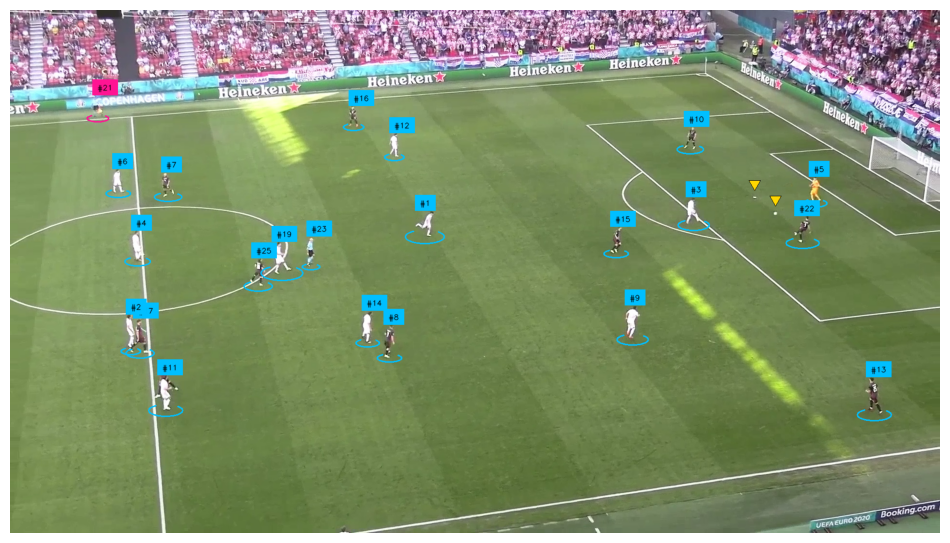

Frame 10


Processing...:  32%|███▏      | 10/31 [00:22<00:48,  2.29s/it]

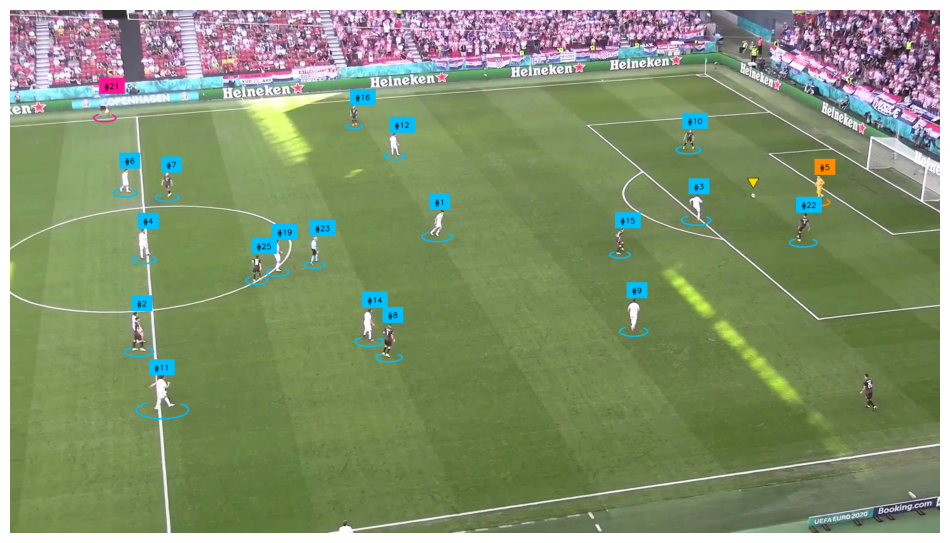

Frame 11


Processing...:  35%|███▌      | 11/31 [00:25<00:52,  2.61s/it]

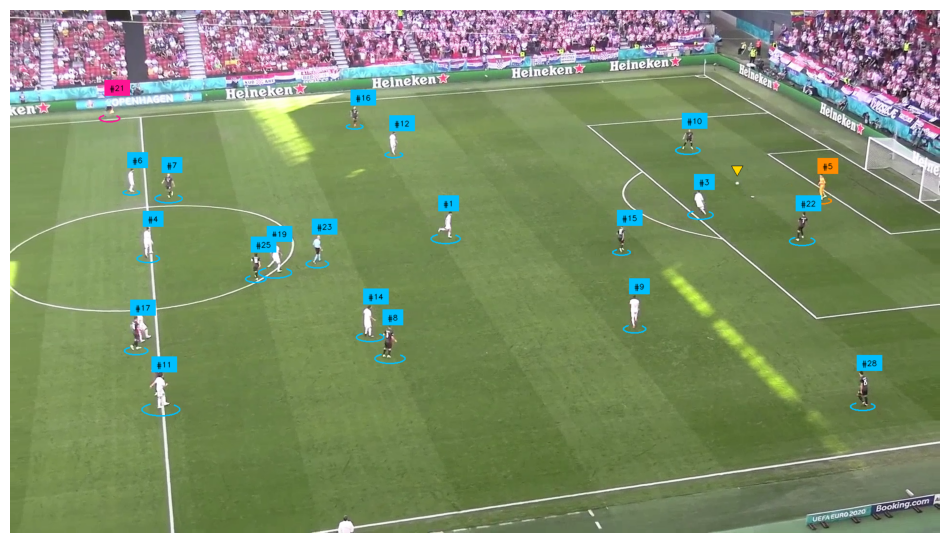

Frame 12


Processing...:  39%|███▊      | 12/31 [00:28<00:53,  2.80s/it]

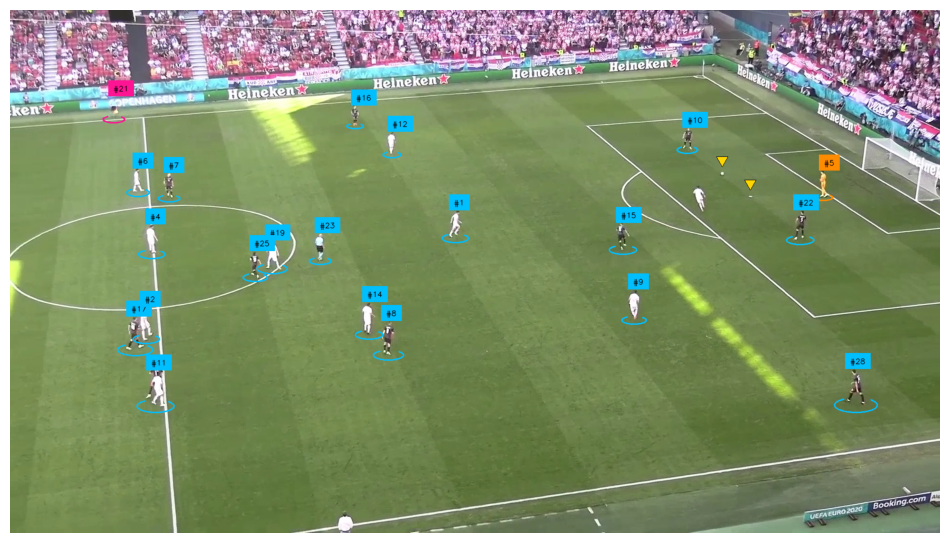

Frame 13


Processing...:  42%|████▏     | 13/31 [00:32<00:54,  3.03s/it]

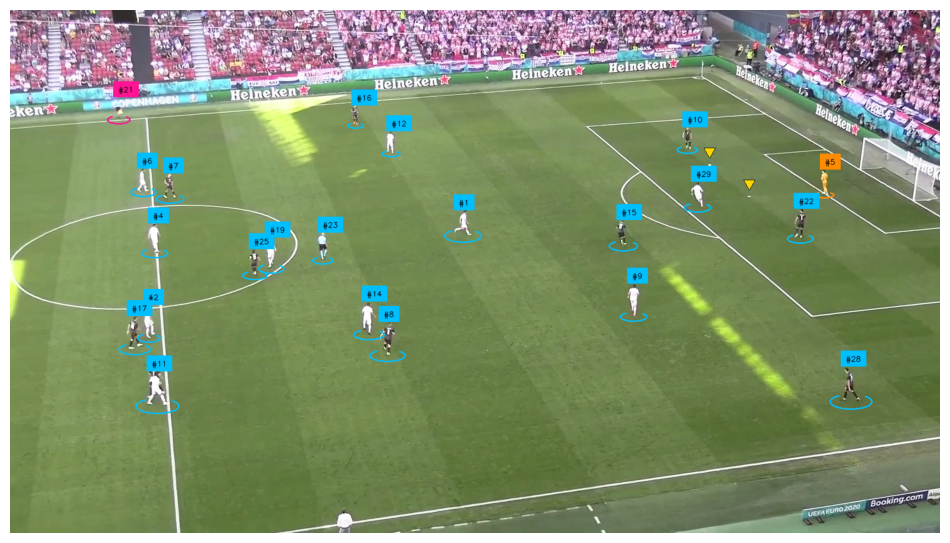

Frame 14


Processing...:  45%|████▌     | 14/31 [00:35<00:54,  3.18s/it]

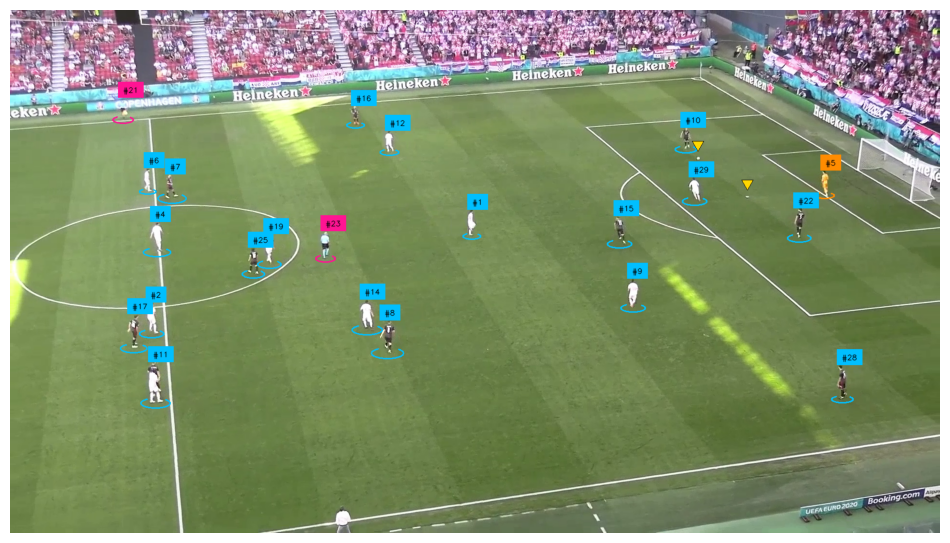

Frame 15


Processing...:  48%|████▊     | 15/31 [00:39<00:50,  3.18s/it]

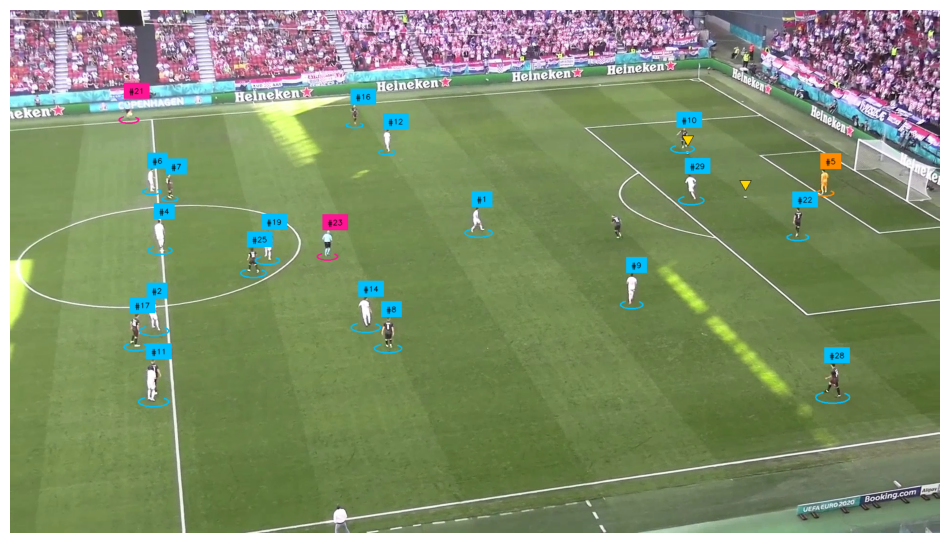

Frame 16


Processing...:  52%|█████▏    | 16/31 [00:42<00:50,  3.38s/it]

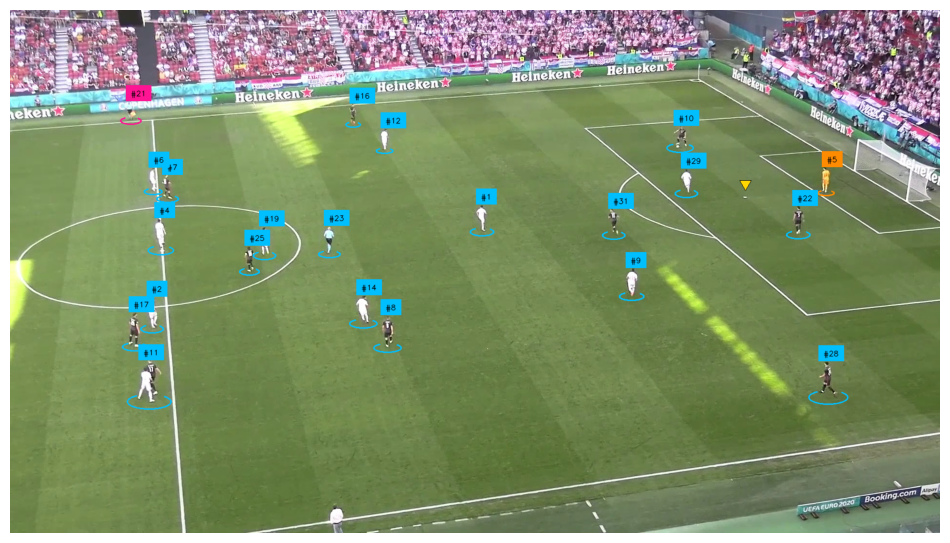

Frame 17


Processing...:  55%|█████▍    | 17/31 [00:45<00:43,  3.13s/it]

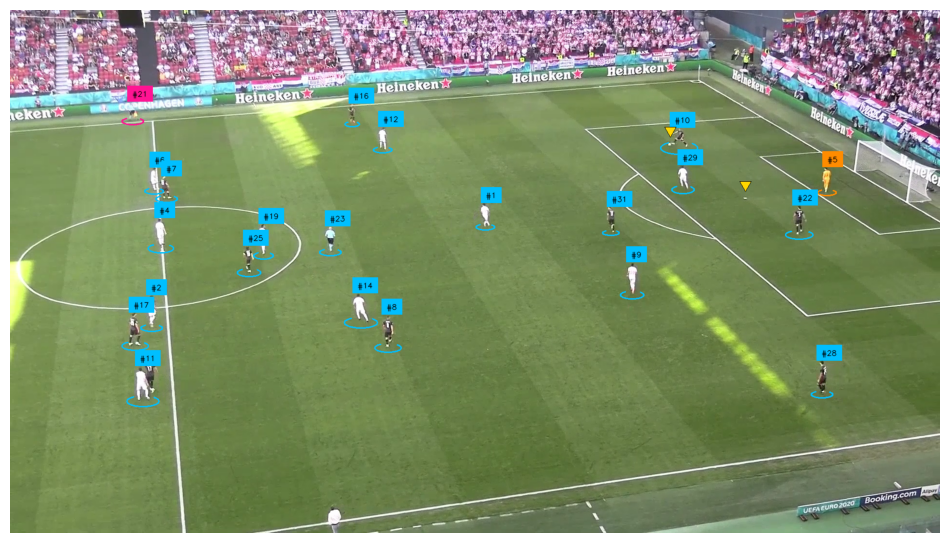

Frame 18


Processing...:  58%|█████▊    | 18/31 [00:47<00:37,  2.90s/it]

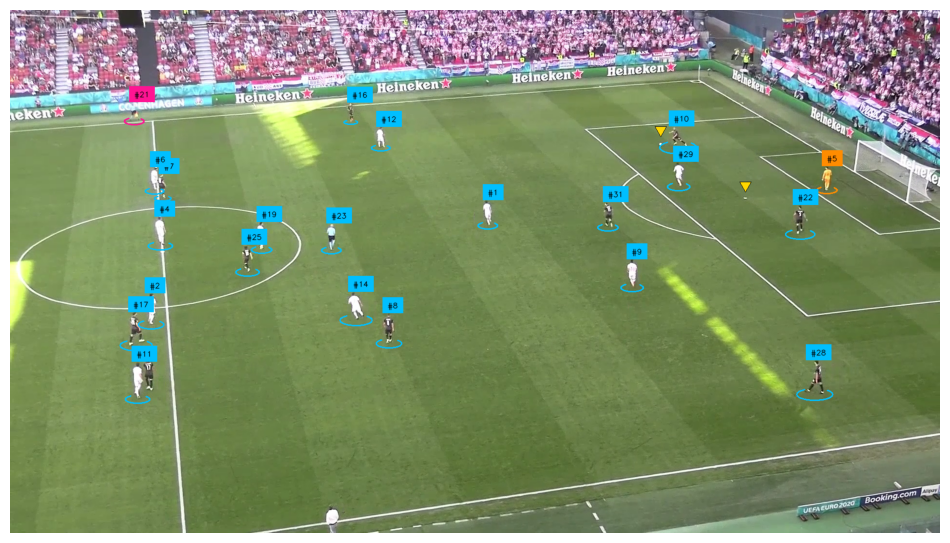

Frame 19


Processing...:  61%|██████▏   | 19/31 [00:50<00:33,  2.76s/it]

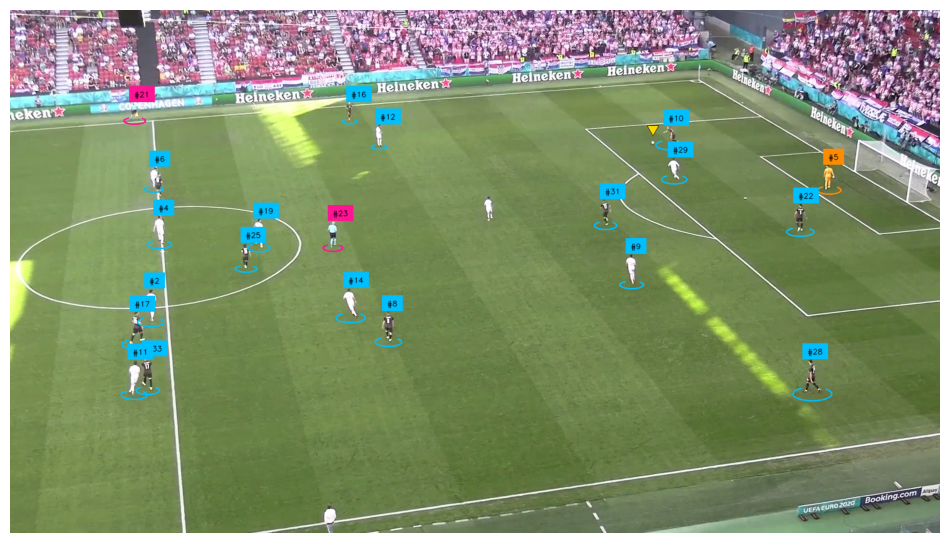

Frame 20


Processing...:  65%|██████▍   | 20/31 [00:53<00:30,  2.82s/it]

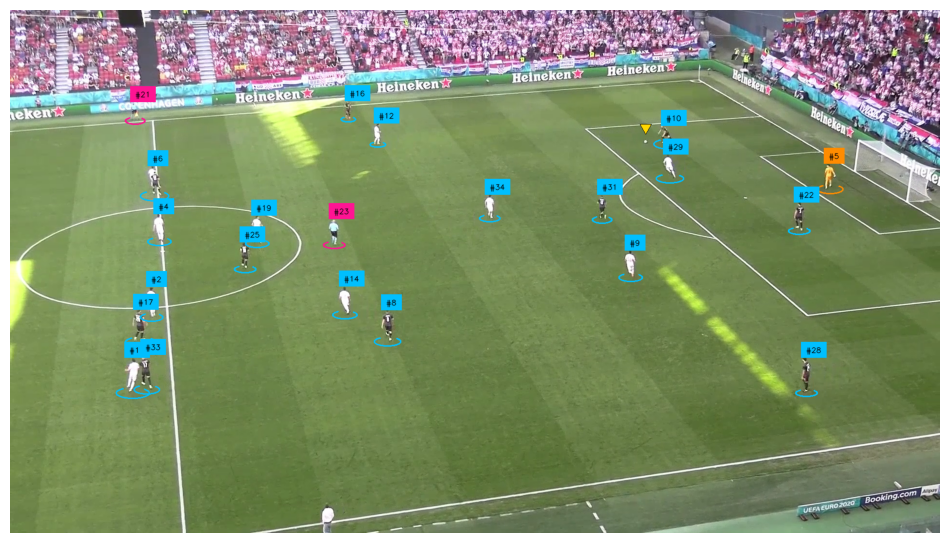

Frame 21


Processing...:  68%|██████▊   | 21/31 [00:54<00:24,  2.49s/it]

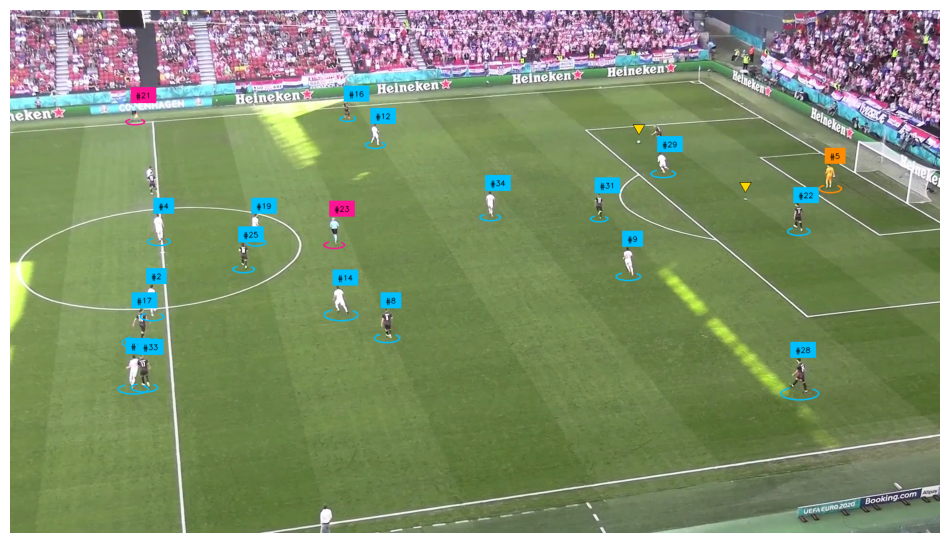

Frame 22


Processing...:  71%|███████   | 22/31 [00:56<00:20,  2.31s/it]

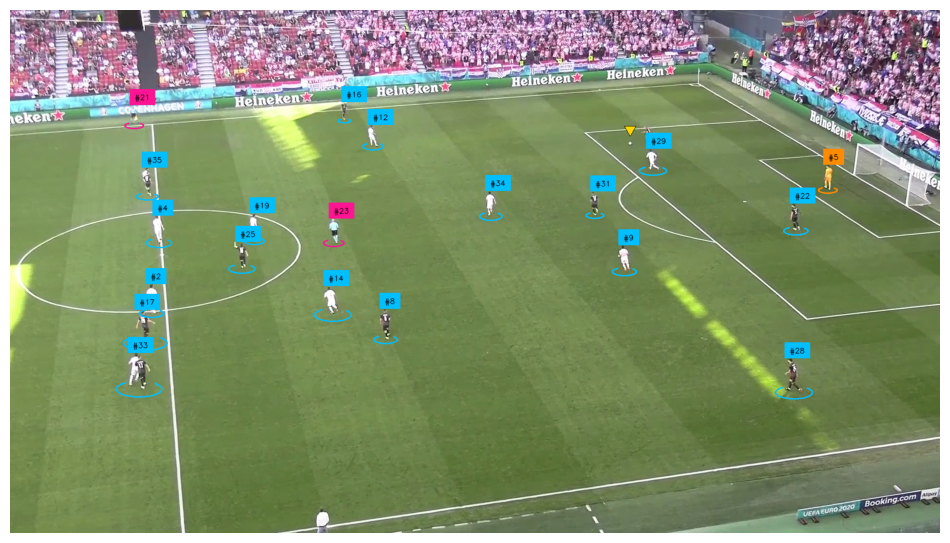

Frame 23


Processing...:  74%|███████▍  | 23/31 [00:59<00:20,  2.50s/it]

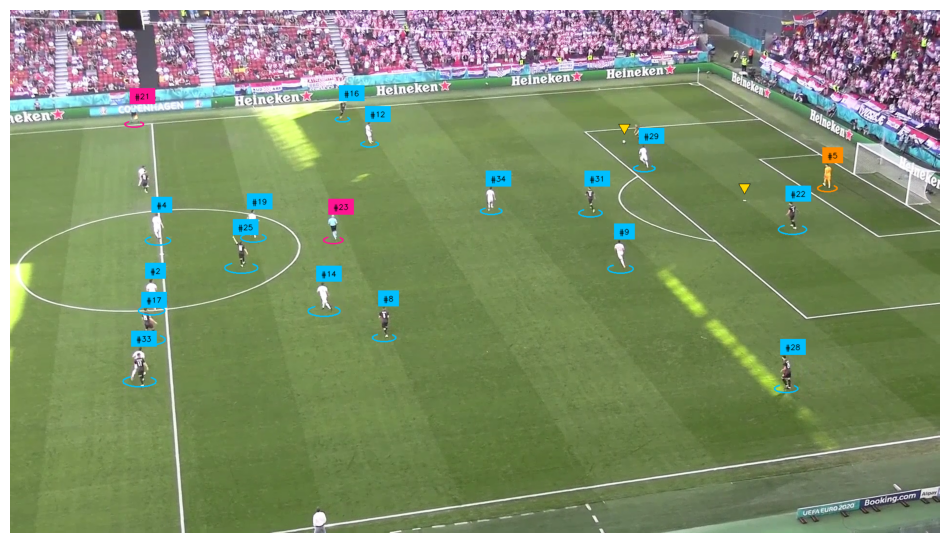

Frame 24


Processing...:  77%|███████▋  | 24/31 [01:02<00:18,  2.64s/it]

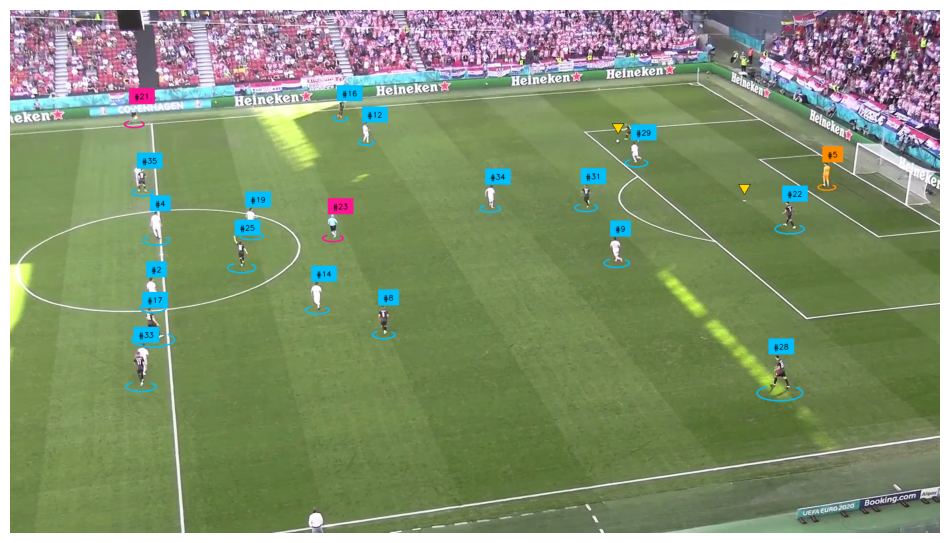

Frame 25


Processing...:  81%|████████  | 25/31 [01:05<00:15,  2.56s/it]

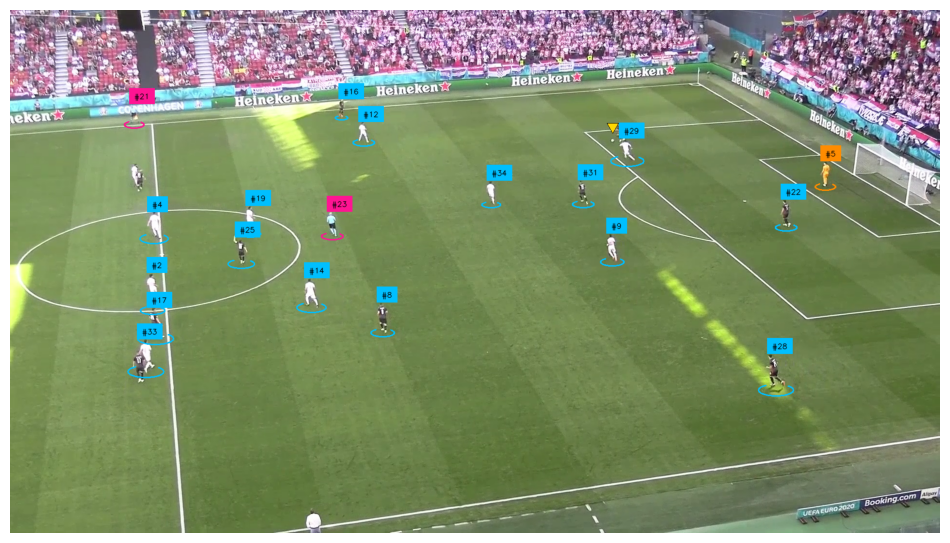

Frame 26


Processing...:  84%|████████▍ | 26/31 [01:07<00:12,  2.56s/it]

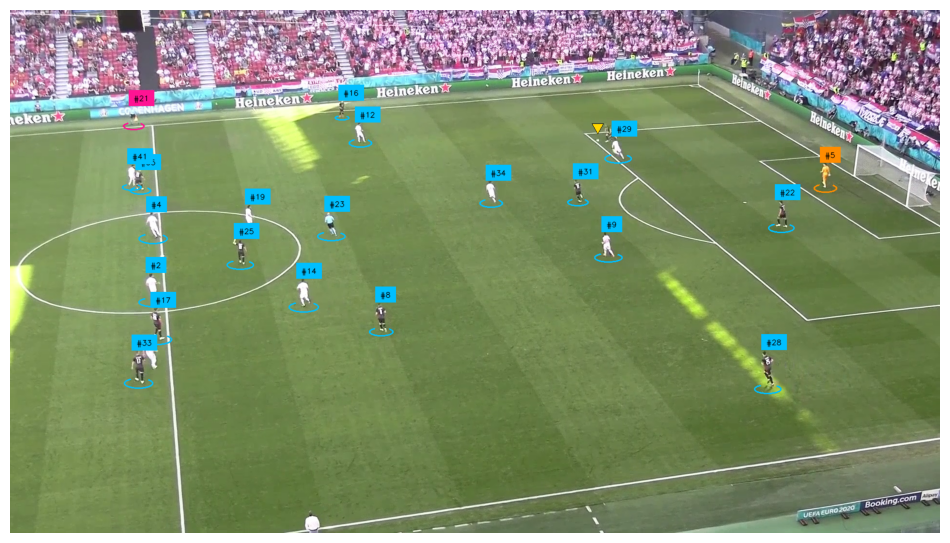

Frame 27


Processing...:  87%|████████▋ | 27/31 [01:10<00:10,  2.64s/it]

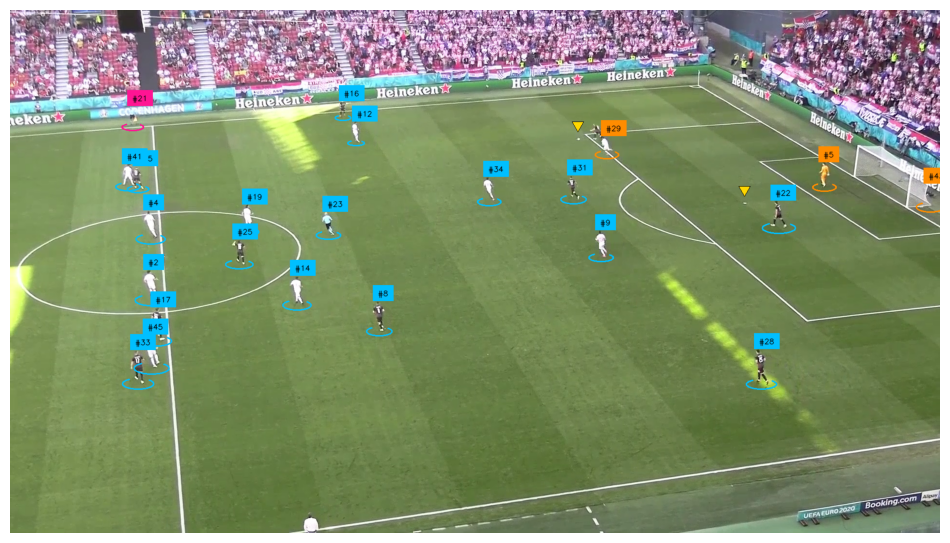

Frame 28


Processing...:  90%|█████████ | 28/31 [01:12<00:07,  2.59s/it]

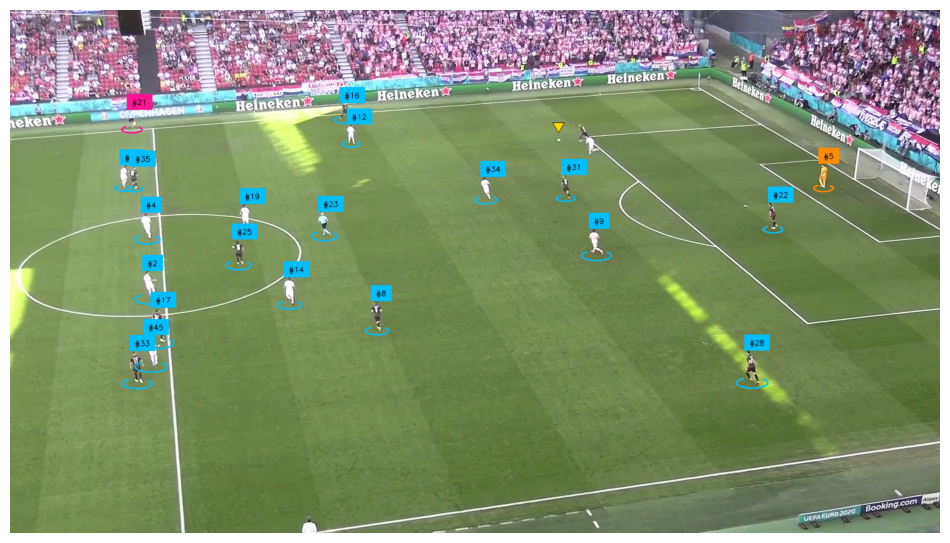

Frame 29


Processing...:  94%|█████████▎| 29/31 [01:15<00:05,  2.58s/it]

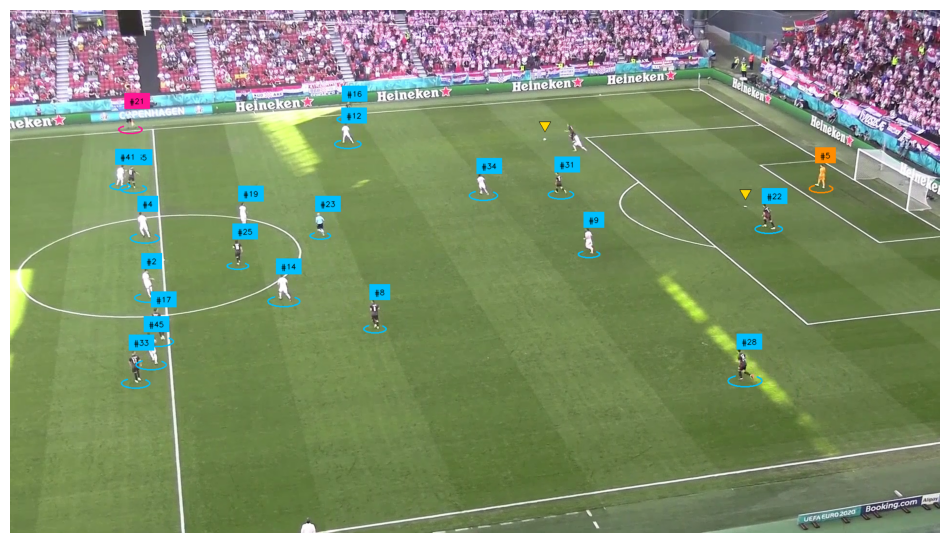

Frame 30


Processing...:  97%|█████████▋| 30/31 [01:18<00:02,  2.72s/it]

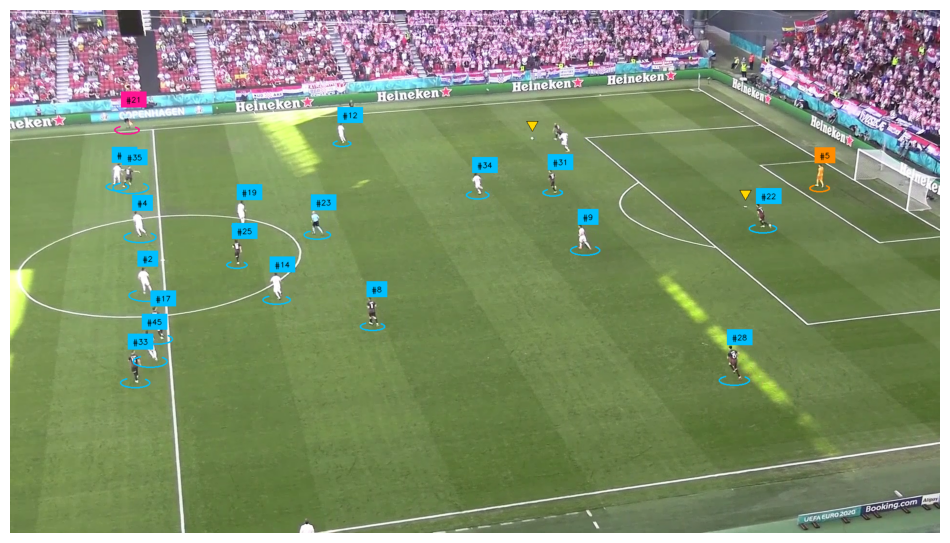

Processing...: 100%|██████████| 31/31 [01:21<00:00,  2.63s/it]


In [62]:
annotated_frames = []
positions_by_id = {}

# Tracker
tracker = sv.ByteTrack()
tracker.reset()

# Maintain a dictionary for expired IDs and their last known bbox
expired_ids = {}

# Update the loop to handle reassignment of IDs
for frame_index, frame in enumerate(tqdm(frames, desc="Processing...")):
    tqdm.write(f"Frame {frame_index}")

    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)

    ball_detections = detections[detections.class_id == BALL_ID]
    ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

    # Filter out player detections
    player_detections = detections[detections.class_id == PLAYER_ID]
    
    all_detections = detections[detections.class_id != BALL_ID]
    all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
    all_detections.class_id -= 1

    # Update the tracker
    all_detections = tracker.update_with_detections(detections=all_detections)

    # Handle reassignment of new IDs to expired IDs
    for tracker_id, bbox in zip(all_detections.tracker_id, all_detections.xyxy):
        if tracker_id not in positions_by_id:
            # Check for similarity with expired IDs
            reassigned_id = None
            for expired_id, expired_bbox in expired_ids.items():
                iou = sv.calculate_iou(bbox, expired_bbox)  # Replace with your IoU calculation function
                if iou > 0.5:  # Threshold for reassignment
                    reassigned_id = expired_id
                    del expired_ids[expired_id]
                    break
            
            if reassigned_id is not None:
                tracker_id = reassigned_id  # Reassign the expired ID

        center_x = (bbox[0] + bbox[2]) / 2  # (xmin + xmax) / 2
        center_y = (bbox[1] + bbox[3]) / 2

        if tracker_id not in positions_by_id:
            positions_by_id[tracker_id] = []

        # Append frame index and position
        positions_by_id[tracker_id].append((frame_index, center_x, center_y))

    # Update expired IDs with bboxes of IDs that are no longer active
    active_ids = set(all_detections.tracker_id)
    for expired_id in list(expired_ids.keys()):
        if expired_id not in active_ids:
            expired_ids[expired_id] = positions_by_id[expired_id][-1][1:]  # Last known bbox

    labels = [
        f"#{tracker_id}"
        for tracker_id in all_detections.tracker_id
    ]

    annotated_frame = frame.copy()
    annotated_frame = ellipse_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections
    )
    annotated_frame = label_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections,
        labels=labels
    )
    annotated_frame = triangle_annotator.annotate(
        scene=annotated_frame,
        detections=ball_detections
    )

    annotated_frames.append(annotated_frame)

    sv.plot_image(annotated_frame)

In [63]:

# Print positions for each ID by frame
for tracker_id, positions in positions_by_id.items():
    print(f"ID {tracker_id}:")
    for frame_index, center_x, center_y in positions:
        print(f"  Frame {frame_index}: ({center_x:.2f}, {center_y:.2f})")



ID 1:
  Frame 0: (771.50, 425.50)
  Frame 1: (772.00, 425.00)
  Frame 2: (773.50, 427.00)
  Frame 3: (779.50, 425.50)
  Frame 4: (786.50, 429.00)
  Frame 5: (798.50, 431.50)
  Frame 6: (810.00, 436.00)
  Frame 7: (825.00, 440.00)
  Frame 8: (838.50, 440.50)
  Frame 9: (856.00, 442.00)
  Frame 10: (881.50, 441.00)
  Frame 11: (899.00, 444.50)
  Frame 12: (919.50, 443.00)
  Frame 13: (935.00, 440.50)
  Frame 14: (953.00, 440.50)
  Frame 15: (967.00, 434.00)
  Frame 16: (974.00, 430.50)
  Frame 17: (981.50, 424.00)
  Frame 18: (986.00, 419.50)
ID 2:
  Frame 0: (162.50, 677.00)
  Frame 1: (167.00, 677.50)
  Frame 2: (170.50, 680.00)
  Frame 3: (180.50, 678.00)
  Frame 4: (194.50, 681.00)
  Frame 5: (203.50, 683.00)
  Frame 6: (213.50, 679.00)
  Frame 7: (227.50, 676.00)
  Frame 8: (240.00, 671.50)
  Frame 9: (249.00, 667.00)
  Frame 10: (266.00, 664.00)
  Frame 12: (281.50, 646.50)
  Frame 13: (286.50, 643.50)
  Frame 14: (292.50, 636.50)
  Frame 15: (297.00, 629.50)
  Frame 16: (293.50, 6

In [60]:
import csv

# Save positions to a CSV file
output_csv_path = "../data/raw/players_positions.csv"

# Get all unique frame indices and tracker IDs
all_frames = sorted(set(frame_index for positions in positions_by_id.values() for frame_index, _, _ in positions))
all_tracker_ids = sorted(positions_by_id.keys())

# Create a dictionary to store (x, y) positions for each tracker ID per frame
frame_tracker_positions = {frame: {tracker_id: None for tracker_id in all_tracker_ids} for frame in all_frames}

# Populate the dictionary with actual positions
for tracker_id, positions in positions_by_id.items():
    for frame_index, center_x, center_y in positions:
        frame_tracker_positions[frame_index][tracker_id] = (center_x, center_y)

# Write the data to a CSV file
with open(output_csv_path, mode="w", newline="") as csv_file:
    csv_writer = csv.writer(csv_file)
    
    # Write the header: Frame and Tracker IDs
    header = ["Frame"] + [f"Tracker {tracker_id}" for tracker_id in all_tracker_ids]
    csv_writer.writerow(header)
    
    # Write the rows: Frame index and (x, y) positions
    for frame_index in all_frames:
        row = [frame_index]
        for tracker_id in all_tracker_ids:
            position = frame_tracker_positions[frame_index][tracker_id]
            if position:
                row.append(f"({position[0]:.2f}, {position[1]:.2f})")
            else:
                row.append("")  # Leave empty if no position for this tracker ID in this frame
        csv_writer.writerow(row)

print(f"Player positions saved to {output_csv_path}")

Player positions saved to ../data/raw/players_positions.csv
